# <font color='dark'>**Validação de modelos e métricas de avaliação**</h1>

### Projeto

Uma empresa de empréstimo de automóveis está passando por uma situação complicada, com alta demanda para uma frota reduzida de veículos e alto número de inadimplentes, trazendo um prejuízo grande para a empresa.

Nós fomos contratados para buscar melhorias na identificação de inadimplentes. A análise dos clientes atualmente é feita de forma manual, cliente por cliente, tomando muito tempo e ainda assim a detecção de inadimplentes é muito imprecisa.

Nossa tarefa é utilizar os dados fornecidos pela empresa para **classificar** os clientes em adimplentes e inadimplentes.

## <font color='dark'>Análise Exploratória e Pré-processamento</h1>

# <font color='red'> Biblioteca </font>

In [136]:
import pandas as pd
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

## <font color='red'> Importar dados </font>

In [137]:
dados = pd.read_csv('https://raw.githubusercontent.com/paolasouza/ml_emprestimo_automoveis/main/emp_automovel.csv')
dados.head()

,receita_cliente,anuidade_emprestimo,anos_casa_propria,telefone_trab,avaliacao_cidade,score_1,score_2,score_3,score_social,troca_telefone,inadimplente
0,12600.0,3569.400000,12.157324,1,2.0,0.057153,0.527227,0.513171,0.117428,2545.0,0
1,9000.0,2722.188351,7.000000,0,2.0,0.657661,0.285898,0.614414,0.222700,495.0,0
2,15750.0,4477.500000,12.000000,0,2.0,0.501213,0.695423,0.513171,0.117428,1212.0,0
3,9000.0,1309.050000,12.157324,0,3.0,0.501213,0.155973,0.513171,0.117428,515.0,0
4,7650.0,1125.000000,12.157324,0,2.0,0.294328,0.152076,0.513171,0.117428,162.0,0


In [138]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54025 entries, 0 to 54024
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   receita_cliente      54025 non-null  float64
 1   anuidade_emprestimo  54025 non-null  float64
 2   anos_casa_propria    54025 non-null  float64
 3   telefone_trab        54025 non-null  int64  
 4   avaliacao_cidade     54025 non-null  float64
 5   score_1              54025 non-null  float64
 6   score_2              54025 non-null  float64
 7   score_3              54025 non-null  float64
 8   score_social         54025 non-null  float64
 9   troca_telefone       54025 non-null  float64
 10  inadimplente         54025 non-null  int64  
dtypes: float64(9), int64(2)
memory usage: 4.5 MB


In [139]:
dados.describe()

,receita_cliente,anuidade_emprestimo,anos_casa_propria,telefone_trab,avaliacao_cidade,score_1,score_2,score_3,score_social,troca_telefone,inadimplente
count,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000,54025.000000
mean,17410.722321,2779.063672,12.147035,0.278075,2.022922,0.490915,0.522771,0.512252,0.117734,975.491009,0.087293
std,9658.762569,1305.364734,7.452120,0.448055,0.498807,0.142389,0.875945,0.062725,0.076180,818.141709,0.282266
min,2700.000000,218.700000,0.000000,0.000000,1.000000,0.014568,0.000005,0.000527,0.000000,0.000000,0.000000
25%,11700.000000,2002.500000,12.157324,0.000000,2.000000,0.492810,0.407054,0.513171,0.091800,302.000000,0.000000
50%,16855.246324,2722.188351,12.157324,0.000000,2.000000,0.501213,0.554789,0.513171,0.117428,810.000000,0.000000
75%,20250.000000,3199.500000,12.157324,1.000000,2.000000,0.501213,0.659141,0.513171,0.117428,1563.000000,0.000000
max,450000.000000,22500.000000,69.000000,1.000000,3.000000,0.942680,100.000000,0.869211,1.000000,4185.000000,1.000000


In [140]:
dados.isnull().sum()

,0
receita_cliente,0
anuidade_emprestimo,0
anos_casa_propria,0
telefone_trab,0
avaliacao_cidade,0
score_1,0
score_2,0
score_3,0
score_social,0
troca_telefone,0


### Diferentes Variáveis

In [141]:
dados['inadimplente'].value_counts()

,count
inadimplente,
0,49309
1,4716


In [142]:
#Identificando tipos de variaveis do banco de dados
for col in dados.columns:
  print(col, dados[col].unique())

receita_cliente [ 12600.           9000.          15750.           7650.
  18000.          22500.          16855.24632415  24750.
  29250.          44550.          27000.          16650.
  36000.          11250.          10800.          10350.
  33750.          21600.           9900.          13500.
   6750.          17100.          20250.          44100.
   9450.          49500.           9540.           5400.
  31500.           8100.          17505.           8550.
  40500.          22050.          42750.          67500.
  13050.          16200.          23490.          12150.
  19800.          14400.          16290.           7200.
  11700.          30150.          54000.          58500.
  20700.          29700.          17820.          66150.
  19350.          17595.          35100.          15300.
  56250.           8865.           5850.          25200.
  23850.          16470.          27450.          23400.
   7785.          14850.           4500.          30600.
  38250.       

### Variáveis categóricas

In [143]:
import plotly.express as px

In [144]:
px.histogram(dados, x = 'inadimplente', text_auto = True) # variável alvo

In [145]:
px.histogram(dados, x = 'telefone_trab', text_auto = True)

In [146]:
px.histogram(dados, x = 'telefone_trab', text_auto = True, color = 'inadimplente',barmode = 'group')

### Variáveis numéricas

In [147]:
import plotly.express as px

In [148]:
px.box(dados, x = 'receita_cliente', color = 'inadimplente')

In [149]:
px.box(dados, x = 'anos_casa_propria', color = 'inadimplente')

In [150]:
px.box(dados, x = 'avaliacao_cidade', color = 'inadimplente')

In [151]:
px.box(dados, x = 'score_1', color = 'inadimplente')

In [152]:
px.box(dados, x = 'score_2', color = 'inadimplente')

In [153]:
px.box(dados, x = 'score_3', color = 'inadimplente')

In [154]:
px.box(dados, x = 'score_social', color = 'inadimplente')

In [155]:
px.box(dados, x = 'troca_telefone', color = 'inadimplente')

In [156]:
px.histogram(dados, x = 'avaliacao_cidade', text_auto = True, color = 'inadimplente', barmode = 'group')

## <font color='dark'>Classificando dados</h1>

### Criando um modelo inicial

In [157]:
#biblioteca para balancear os dados utilizando over_sampling
from imblearn.over_sampling import SMOTE

In [158]:
# separar features (x) e classificação (y)

X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

*   A primeira árvore estava com overfiting


In [159]:
#Bibliotecas
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.tree import DecisionTreeClassifier

In [160]:
SEED = 5
np.random.seed(SEED)
dtc = DecisionTreeClassifier() #Istanciando o modelo
dtc.fit(X,y) #Treinando o modelo
dtc.score(X,y) #Avaliando o modelo

dtc_accuracy = dtc.score(X,y) * 100

print(f'A Acurácia do modelo decision tree foi de {dtc_accuracy:.2f} %')

A Acurácia do modelo decision tree foi de 100.00 %


In [161]:
#Gráfico árvore de decisão

from sklearn.tree import export_graphviz
import graphviz

features = X.columns
dot_data = export_graphviz(dtc, out_file = None,
                           feature_names = features,
                           filled = True,
                           rounded = True,
                           special_characters=True)
grafico = graphviz.Source(dot_data)
grafico

A Acurácia do modelo decision tree foi de 90.95 %


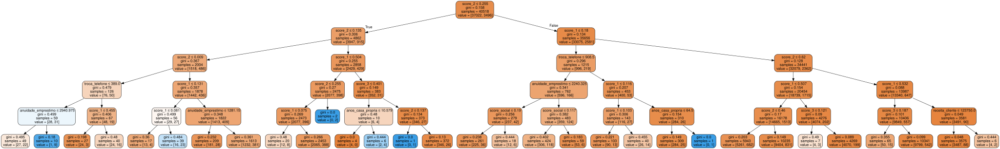

In [162]:
# Outro exemplo
#criar um modelo de árvore de decisão
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import numpy as np

SEED = 5

train_x, test_x, train_y, test_y = train_test_split(X, y, test_size = 0.25, random_state = SEED)


dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #Istanciando o modelo
dtc.fit(train_x, train_y) #Treinando o modelo

dtc_accuracy = dtc.score(test_x, test_y) * 100
print(f'A Acurácia do modelo decision tree foi de {dtc_accuracy:.2f} %')

#Gráfico árvore de decisão

from sklearn.tree import export_graphviz
import graphviz

features = X.columns
dot_data = export_graphviz(dtc, out_file = None,
                           feature_names = features,
                           filled = True,
                           rounded = True,
                           special_characters=True)
grafico = graphviz.Source(dot_data)
grafico

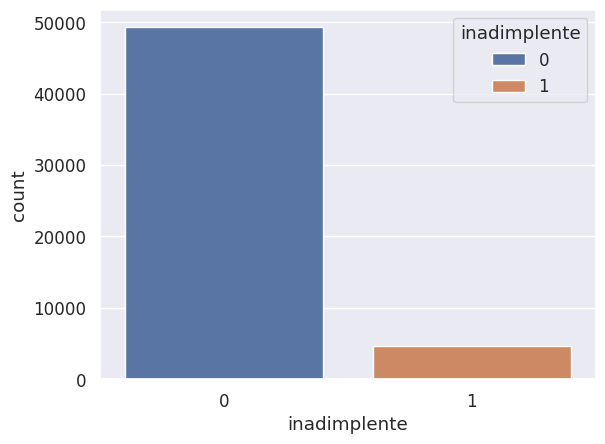

In [163]:
#varialvel target está desbalanceada

import seaborn as sns
ax = sns.countplot(x= 'inadimplente', hue = 'inadimplente', data = dados)

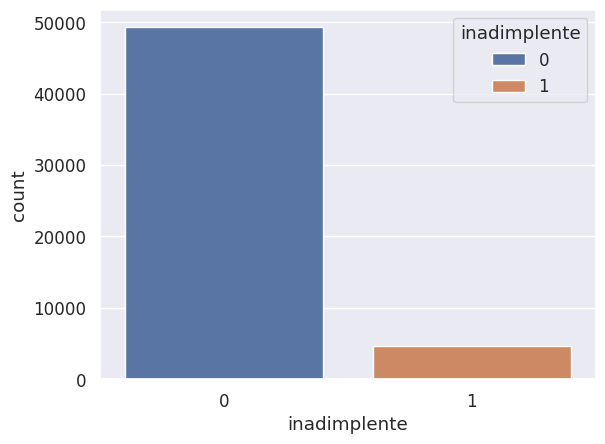

In [164]:
#Gerando mais dados
ax = sns.countplot(x= 'inadimplente', hue = 'inadimplente', data = dados)

## <font color="orange"> Criando um modelo inicial

### <font color="orange"> Dummy Baseline

In [165]:
from sklearn.dummy import DummyClassifier
from sklearn.metrics import accuracy_score
from  sklearn.model_selection import train_test_split
import numpy as np

In [166]:
SEED = 123
np.random.seed(SEED)

train_x, test_x, train_y, test_y = train_test_split(X, y, test_size = 0.25, random_state = SEED)

In [167]:
from sklearn.dummy import DummyClassifier

dummy_stratifield = DummyClassifier() #Cria modelo
dummy_stratifield.fit(train_x, train_y) #Treina modelo
dummy_stratifield.score(test_x, test_y) #Avalia modelo

acuracia_dummy = dummy_stratifield.score(test_x, test_y) * 100
print(f'A Acurácia do modelo dummy stratifield foi de {acuracia_dummy:.2f} %')

A Acurácia do modelo dummy stratifield foi de 91.15 %


### Validando o modelo

Avaliar os modelo com base nos mesmos dados usados no treinamento não é interessante. É preciso que a avaliação seja feita em dados independentes.

Avaliar o modelo nos próprios dados de treinamento seria o análogo a entregar uma prova com as questões e o gabarito para uma pessoa e no momento de avaliá-la novamente, entregar uma prova com as mesmas questões e alternativas. É esperado que essa pessoa se sairá bem por já ter visto as respostas e ter decorado o resultado. Isso é diferente de ter aprendido a matéria a partir daquela prova e depois fazer uma prova com conteúdo parecido e ter um resultado positivo.

No intuito de checar a generalização de um modelo, devemos separar o conjunto de dados em 3 partes: dados de treinamento, validação e teste.

- o conjunto de treinamento é utilizado para treinar os modelos. Os modelos vão entender o padrão dos dados a partir desse conjunto de dados.

- o conjunto de validação é utilizado para avaliar o desempenho de diferentes modelos, com dados novos que não foram usados no treinamento do modelo.

- o conjunto de teste fica separado dos demais desde o momento inicial para simular os dados do mundo real. Ele não é utilizado em nenhum momento no treinamento e nem na validação, servindo como uma estimativa da capacidade do modelo escolhido de generalizar e prever novos dados.

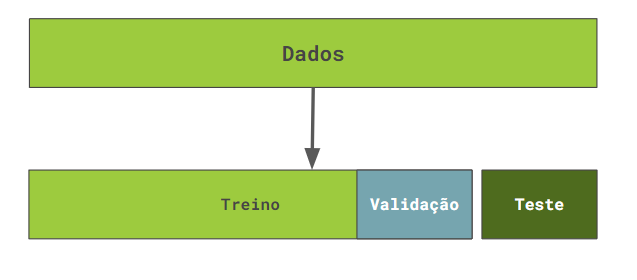

A Acurácia do modelo decision tree foi de 91.24 %


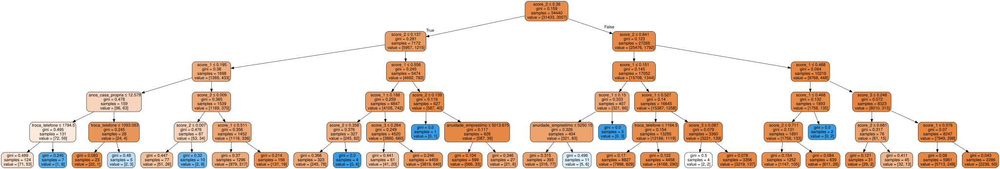

In [168]:
# Outro exemplo - Dividindo em 3 partes
# criar um modelo de arvore de decisão

from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np

# Treino e Teste
SEED = 5
np.random.seed(SEED)
train_x, test_x, train_y, test_y = train_test_split(X, y, test_size = 0.15, random_state = SEED, stratify=y)
x_train_novo, x_validacao, y_train_novo, y_validacao = train_test_split(train_x, train_y, test_size = 0.25, random_state = SEED, stratify=train_y)

dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #Istanciando o modelo
dtc.fit(x_train_novo, y_train_novo) #Treinando o modelo

dtc_accuracy = dtc.score(x_validacao, y_validacao) * 100
print(f'A Acurácia do modelo decision tree foi de {dtc_accuracy:.2f} %')

#Gráfico árvore de decisão

from sklearn.tree import export_graphviz
import graphviz

features = X.columns
dot_data = export_graphviz(dtc, out_file = None,
                           feature_names = features,
                           filled = True,
                           rounded = True,
                           special_characters=True)
grafico = graphviz.Source(dot_data)
grafico


### Avaliando o modelo

In [169]:
#metricas score
previsoes = dtc.predict(x_validacao)
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
print(f"Acurácia: {accuracy_score(y_validacao, previsoes)}")
print(f"Precisão: {precision_score(y_validacao, previsoes)}")
print(f"Recall: {recall_score(y_validacao, previsoes)}")
print(f"F1: {f1_score(y_validacao, previsoes)}")

Acurácia: 0.9123769706471562
Precisão: 0.16666666666666666
Recall: 0.000998003992015968
F1: 0.001984126984126984


## <font color="orange"> Validação dos modelos

### <font color="orange"> Matriz de Confusão

In [170]:
#matriz de confusão
from sklearn.metrics import confusion_matrix

[[10474     5]
 [ 1001     1]]


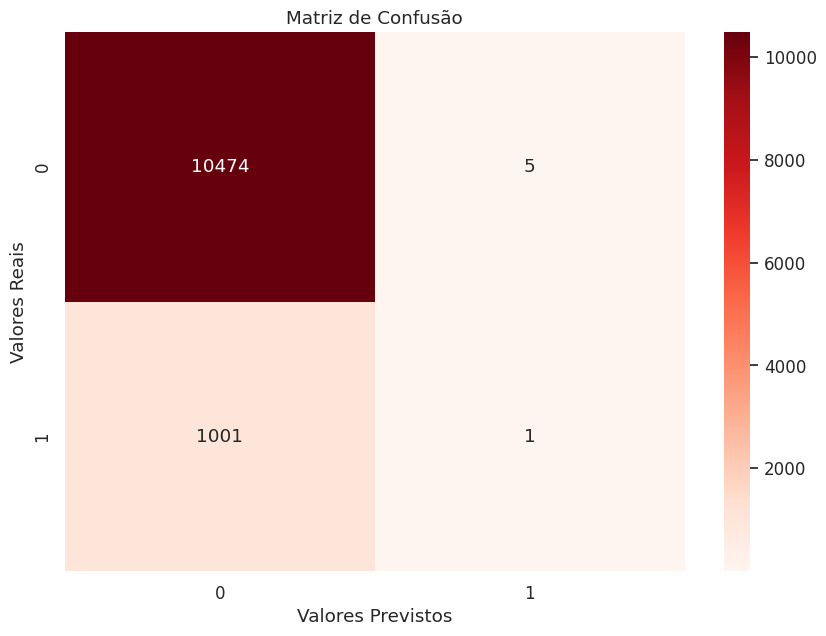

In [171]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calcula a matriz de confusão
cm = confusion_matrix(y_validacao, previsoes)

#Matriz de confusão
from sklearn.metrics import confusion_matrix
mc_dct = confusion_matrix(y_validacao, previsoes) #Árvore de decisão
print(mc_dct)

# Plota a matriz de confusão
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Reds')
plt.xlabel('Valores Previstos')
plt.ylabel('Valores Reais')
plt.title('Matriz de Confusão')
plt.show()


In [172]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def gerando_matriz(matriz_confusao, labels, categorias, cmap="viridis"):
    group_counts = [f"{value}" for value in matriz_confusao.flatten()]
    labels = [f"{v1}" for v1 in labels]
    lb = [f"{v1}\n{v2}" for v1, v2 in zip(labels, group_counts)]
    lb = np.asarray(lb).reshape(matriz_confusao.shape)

    ax = plt.subplot()
    sns.set(font_scale=1.1)
    sns.heatmap(matriz_confusao, annot=lb, ax=ax, cmap=cmap, fmt="", xticklabels=categorias,yticklabels=categorias)

    label_font = {'size':'12'}
    ax.set_xlabel('Valores preditos', fontdict=label_font);
    ax.set_ylabel('Valores verdadeiros', fontdict=label_font);

    ax.tick_params(axis='both', which='major', labelsize=10)


categorias = ["0", "1"]
labels = ['Verdadeiro Negativo','Falso Positivo',
          'Falso Negativo','Verdadeiro Positivo']

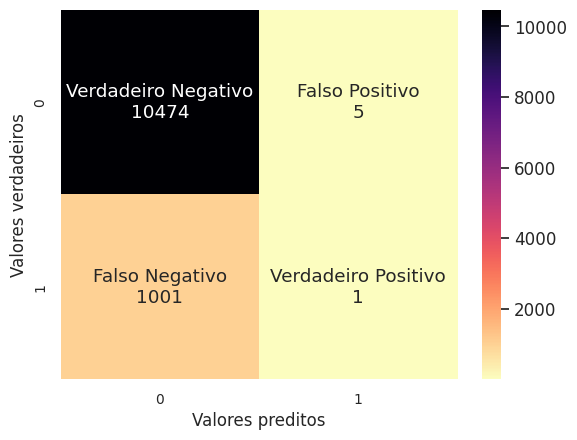

In [173]:
gerando_matriz(mc_dct, labels, categorias, cmap="magma_r")

## <font color='dark'>Métricas de avaliação</h1>

### Acurácia
A partir do calculo da matriz de confusão conseguimos inferir outras métricas, como por exemplo a acurária.




$ACC$ = ${TP + TN \over TP + FP + TN + FN}$

In [174]:
from sklearn.metrics import accuracy_score
accuracy_score(y_validacao, previsoes)

0.9123769706471562

### Precisão

Outra métrica importante é a precisão, que calcula quantos foram classificados corretamento como positivos ($TP$).

$PS$ = ${TP \over TP + FP}$

In [175]:
from sklearn.metrics import precision_score
precision_score(y_validacao, previsoes)

#precision_score, recall_score, f1_score

0.16666666666666666

### Recall

Outra métrica importante é a Recall ou revocação ou ainda sensibilidade, que calcula o quão bom o modelo está para classificar corretamente um resultado positivo ($TP$).

$RC$ = ${TP \over TP + FN}$

In [176]:
from sklearn.metrics import recall_score
recall_score(y_validacao, previsoes)

0.000998003992015968

### Acurácia, precisão e recall

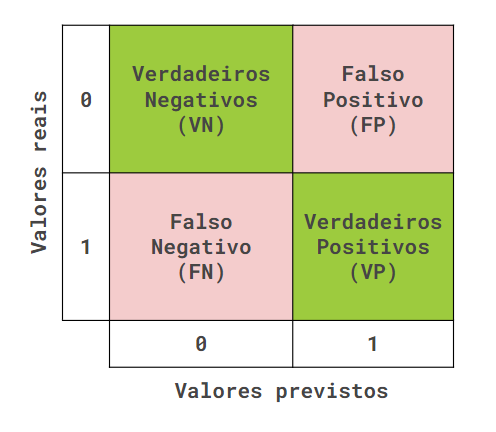

#### Acurácia


É a métrica mais comum e básica em problemas de classificação. É utilizada para medir a proporção de dados previstos corretamente pelo modelo em relação ao total dos dados. Essa métrica é útil quando as classes da variável alvo estão balanceadas, ou seja, quando existe uma quantidade equilibrada de dados para cada classe e uma importância equivalente de classificação entre as categorias. Como exemplo de utilização, temos o reconhecimento de dígitos manuscritos. Podemos utilizar imagens de caracteres de letras e números para treinar um modelo de classificação para identificar corretamente a escrita. Como cada letra ou número não tem uma importância maior do que as demais, a acurácia se torna uma boa métrica para medir a capacidade do modelo em classificar corretamente os dígitos.

Abaixo, podemos analisar o cálculo da acurácia a partir da matriz de confusão. Ela é calculada somando os acertos do modelo (VN + VP) e dividindo por todos os acertos e erros (VP+VN+FP+FN).

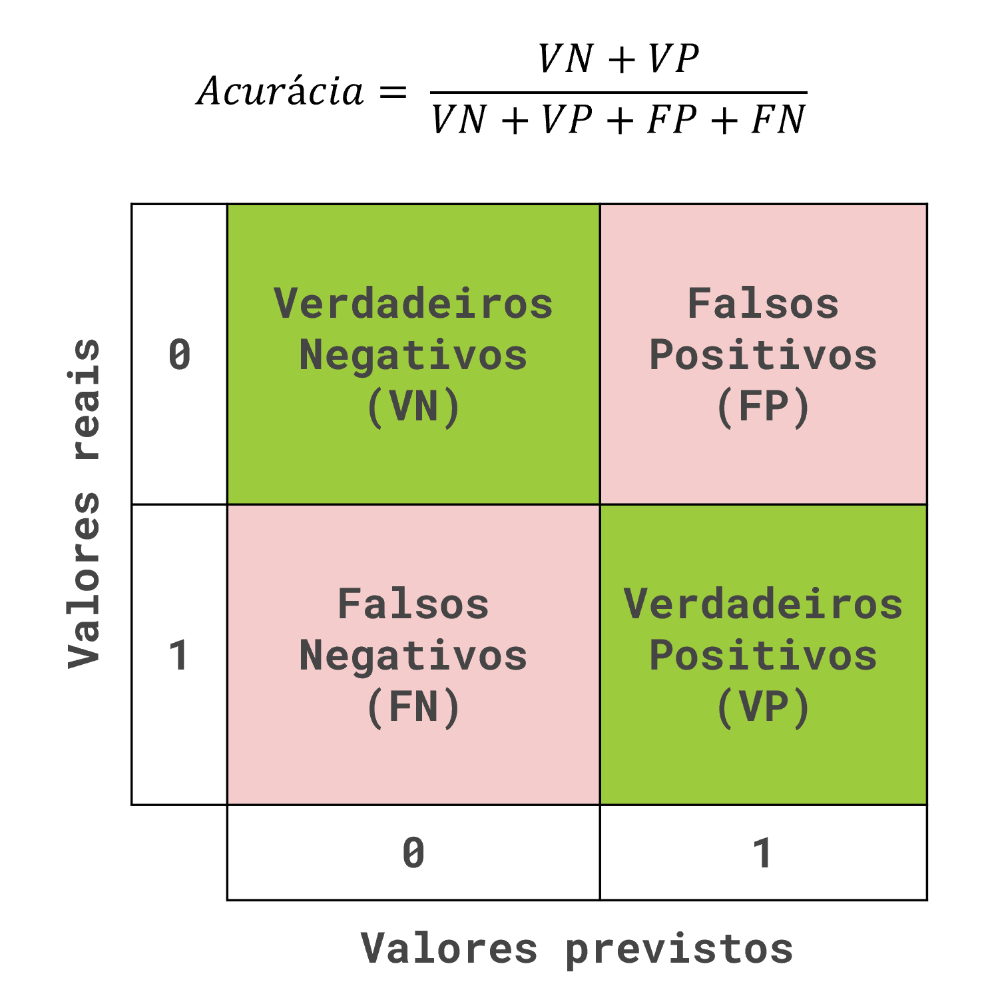

Revocação (recall)
Mede a proporção de dados positivos que foram corretamente identificados pelo modelo, ou seja, revela a capacidade do modelo em evitar a classificação incorreta de dados positivos como negativos. É usada quando o risco ou custo de classificar falsos negativos é alto. Por exemplo, em casos de diagnóstico de doenças graves, em que é fundamental detectar corretamente a presença da doença.

Abaixo podemos constatar o cálculo do recall a partir da matriz de confusão. O recall só leva em consideração os valores positivos reais, ou seja, os valores da segunda linha da matriz. Ele é calculado a partir da divisão entre Verdadeiros Positivos (VP) pela soma de todos os positivos reais (VP + FN):

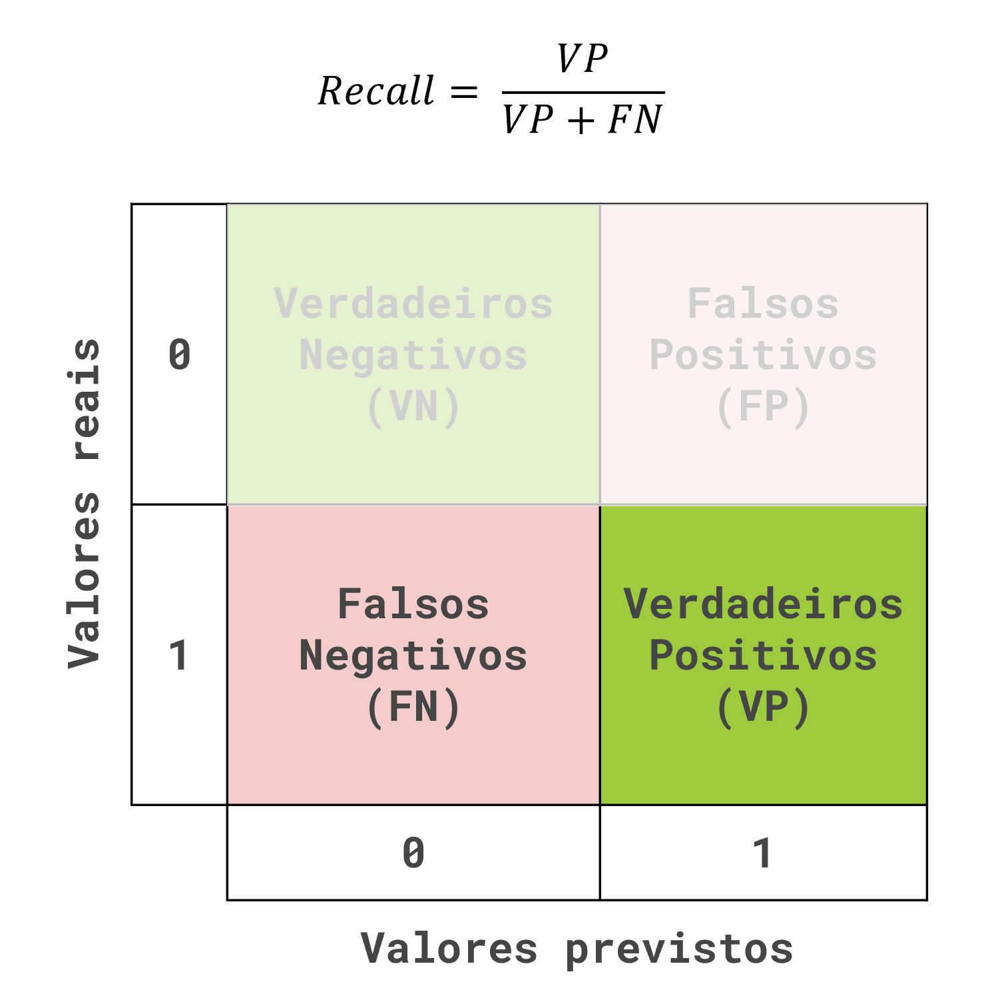




#### Precisão


Mede a proporção de dados classificados como positivos que são realmente positivos, ou seja, revela a capacidade do modelo em evitar a classificação incorreta de dados negativos como positivos. É usada quando o risco ou custo de classificar falsos positivos é alto, por exemplo em casos de seleção de ações no mercado financeiro, onde o importante é selecionar ações que tenham grande probabilidade de retorno, abaixando a quantidade de ações ruins (falsos positivos) mesmo que outras boas ações não tenham sido detectadas pelo modelo (falso negativo). A precisão também é importante no exemplo de detecção de doenças, onde queremos evitar que pacientes saudáveis sejam erroneamente classificados como doentes.

Abaixo podemos analisar o cálculo da precisão a partir da matriz de confusão. A precisão só leva em consideração os valores positivos previstos pelo modelo, ou seja, os valores da segunda coluna da matriz. Ela é calculada a partir da divisão entre Verdadeiros Positivos (VP) pela soma de todos os positivos previstos (VP + FP):

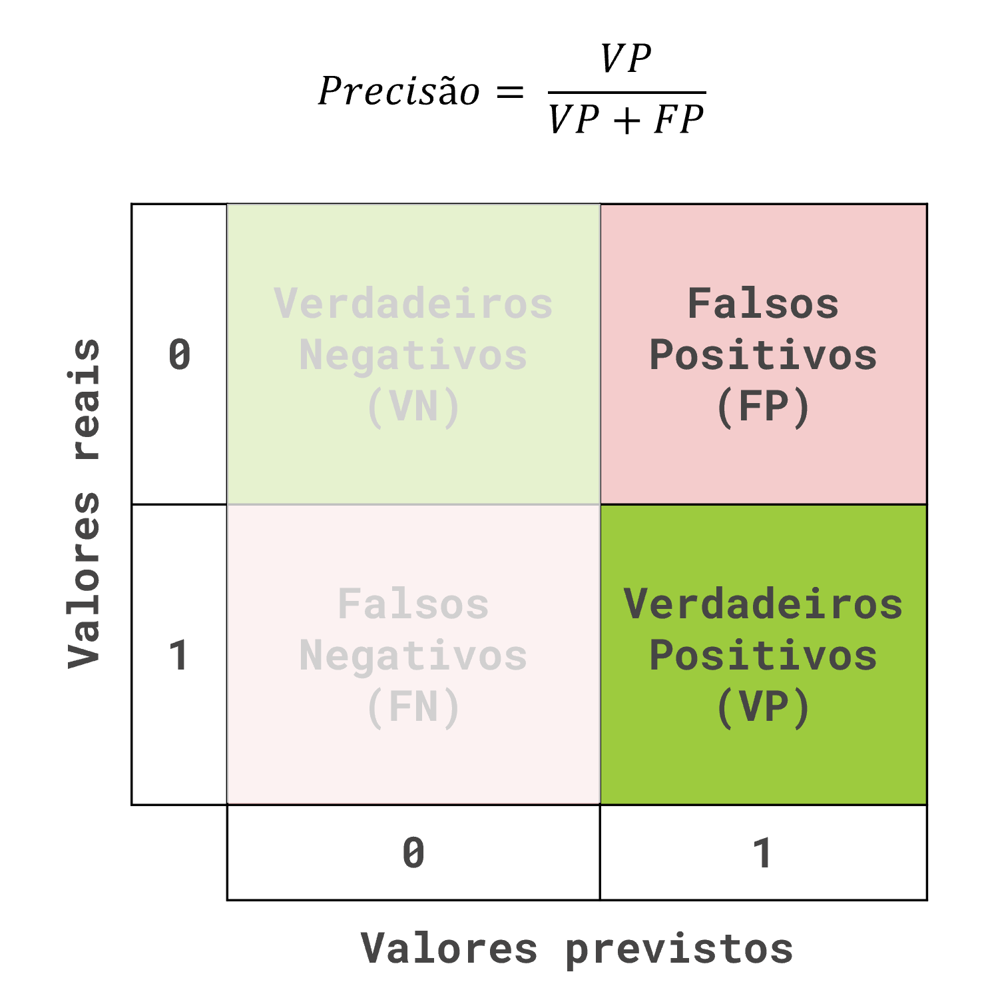

#### F1-Score


Fornece um equilíbrio entre o recall e a precisão, sendo útil quando as classes da variável alvo estão desbalanceadas, ou seja, quando há uma quantidade de dados muito diferente para cada classe. Além disso, é aplicável quando o risco ou custo de falsos positivos e de falsos negativos é alto simultaneamente. Em casos de detecção de tumores em pacientes, é preciso ter um equilíbrio entre evitar erros na detecção de tumores quando a pessoa realmente os possui e evitar erros ao informar que uma pessoa possui um tumor quando na realidade ela não possui.

O cálculo do F1-Score é feito a partir da média harmônica entre a precisão e o recall. Portanto, equivale a 2 vezes a precisão pelo recall, dividido pela soma entre a precisão e o recall:

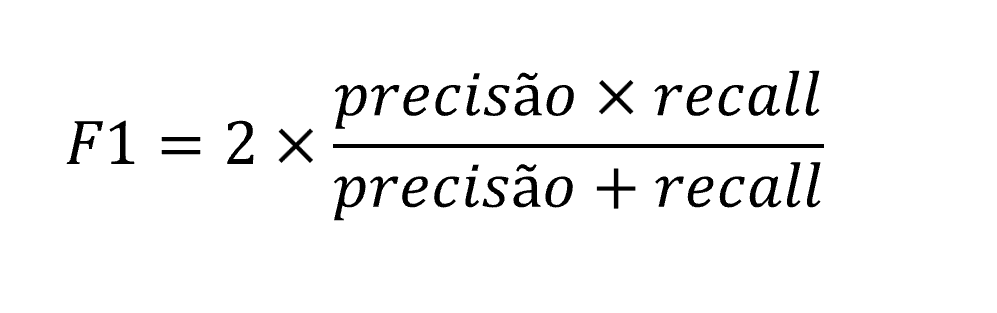

A escolha da métrica de classificação adequada depende do problema que está sendo resolvido e de cada cenário. Nos casos em que as classes estão balanceadas e possuem importância semelhante, a acurácia pode ser uma boa métrica inicial. Porém, quando as classes estão desequilibradas ou os erros têm custos diferentes, métricas como precisão, recall e f1-score são mais indicadas.

### Curva ROC

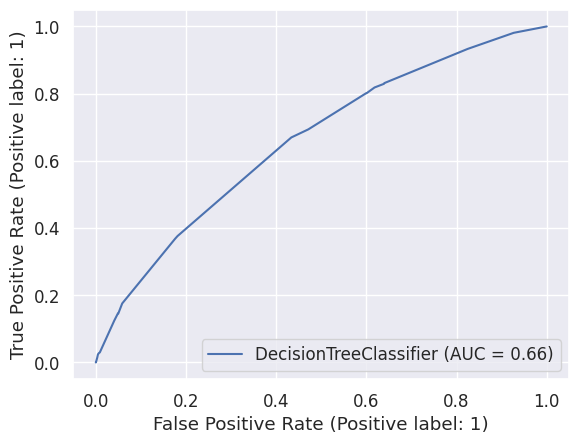

In [177]:
from sklearn.metrics import RocCurveDisplay
import matplotlib.pyplot as plt

RocCurveDisplay.from_estimator(dtc, x_validacao, y_validacao)

### Curva de precisão x recall

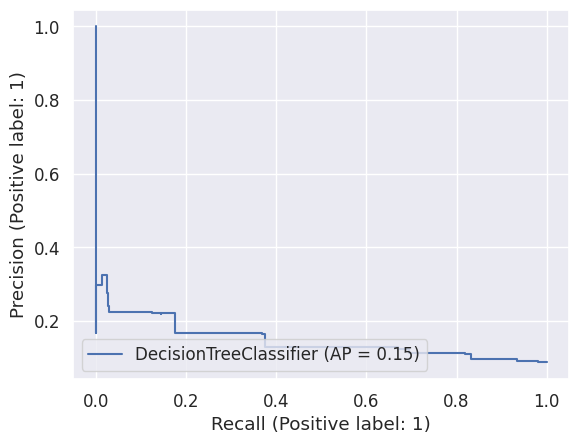

In [178]:
from sklearn.metrics import PrecisionRecallDisplay
PrecisionRecallDisplay.from_estimator(dtc, x_validacao, y_validacao)

### Relatório de métricas

In [179]:
from sklearn.metrics import classification_report

y_pred = dtc.predict(x_validacao)
print(classification_report(y_validacao, y_pred))

              precision    recall  f1-score   support

           0       0.91      1.00      0.95     10479
           1       0.17      0.00      0.00      1002

    accuracy                           0.91     11481
   macro avg       0.54      0.50      0.48     11481
weighted avg       0.85      0.91      0.87     11481



## <font color='dark'>Validação cruzada</h1>

### Usando o KFold

A validação do modelo de classificação a partir da separação dos dados em conjunto de treino e validação faz com que o resultado seja muito dependente dessa divisão dos dados e pode ser que, de forma aleatória, o padrão dos dados de validação sejam diferentes do padrão dos dados de treinamento, levando a sorte de ter um resultado muito melhor do que a realidade ou o azar de um resultado muito pior do que a realidade.

Levando isso em consideração, é possível utilizar a **validação cruzada**, uma estratégia mais consistente e bem mais utilizada nos projetos de machine learning.

Na validação cruzada, ao invés de separarmos os dados em apenas treino e validação uma única vez, dividimos os dados em várias partes de mesmo tamanho. Em cada uma dessas divisões, será utilizada uma parte para validação e todas as outras para treinamento e o processo se repete até que todas as partes sejam utilizadas para validação e o restante para treinamento.

Será gerado um modelo para cada uma dessas divisões e a avaliação de desempenho será feita tirando a média da métrica de cada modelo. Isso faz com que a dependência da separação dos dados seja eliminada, já que há uma variação maior da escolha dos dados e é retirada uma média.

Geralmente são utilizadas 5 ou 10 partes, mais do que isso não é tão necessário porque necessita de um processamento maior e valores menores já mitiga o problema da escolha dos dados.

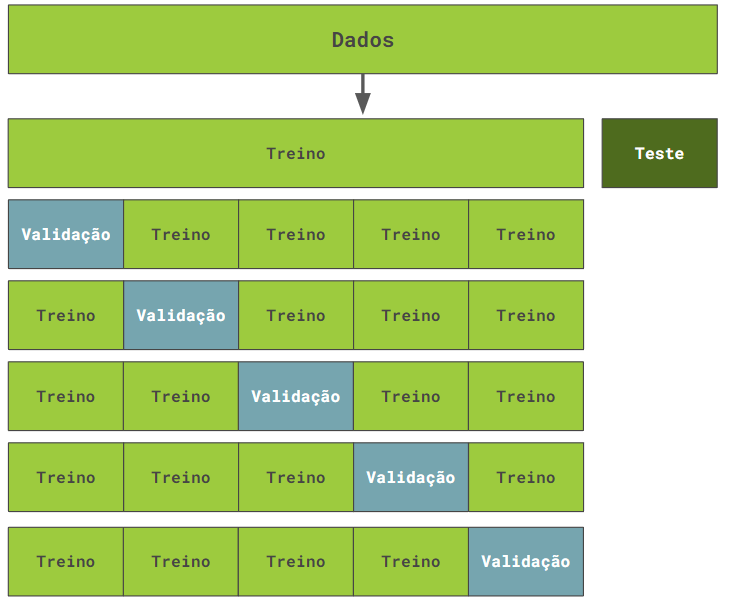

In [180]:
from sklearn.model_selection import KFold, cross_validate

In [181]:
# separar features (x) e classificação (y)

X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

In [182]:
#criar um modelo de árvore de decisão
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #Istanciando o modelo

#divisão dos dados de treino e validação
Kf = KFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada
results = cross_validate(dtc, X, y, cv=Kf, scoring=['accuracy'])
results['test_accuracy']

array([0.90837575, 0.91235539, 0.91207774, 0.91411384, 0.91254049])

In [183]:
from sklearn.model_selection import KFold, cross_validate

In [184]:
# separar features (x) e classificação (y)

x = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

# criar um modelo de arvore de decisão

SEED = 5
modelo = DecisionTreeClassifier(max_depth = 5) #instanciando o modelo

In [185]:
#divisão dos dados de treino e validação
kf = KFold(n_splits = 5, shuffle = True, random_state=SEED) # n_splits = 5 é divido em 5 partes conforme a imagem acima.

#validação cruzada
results = cross_validate(modelo, x, y, cv = kf, scoring = 'recall')
results['test_score']

array([0.01319797, 0.00530223, 0.00214823, 0.        , 0.00107181])

In [186]:
from sklearn.model_selection import KFold, cross_validate
from imblearn.over_sampling import SMOTE
import numpy as np

SEED = 5
np.random.seed(SEED)

#Separar dados de treino e teste
X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#criar um modelo de árvore de decisão
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #Istanciando o modelo

#divisão dos dados de treino e validação
Kf = KFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada
results = cross_validate(dtc, X, y, cv=Kf, scoring='recall')
results['test_score']

array([0.01319797, 0.00530223, 0.00214823, 0.        , 0.00107181])

In [187]:
def intervalo_confianca(results):
  media = results.mean()
  desvio = results.std()
  #print(f'Intervalo de confiaça: {media} +/- {2*desvio}')
  print(f'Intervalo de confiaça: [{max(media - 2*desvio,0)}, {min(media+2*desvio,1)}]')

In [188]:
intervalo_confianca(results['test_score'])

Intervalo de confiaça: [0, 0.013881759454416711]


### Validação cruzada com recall

In [189]:
from sklearn.model_selection import KFold, cross_validate
import numpy as np

SEED = 5
np.random.seed(SEED)

#Separar dados de treino e teste
X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#treino e teste split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=SEED, stratify=y)

#divisão dos dados de treino e validação para cross validacao
Kf = KFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #modelo #criar um modelo de árvore de decisão
results = cross_validate(dtc, X, y, cv=Kf, scoring='recall')

#intervalo de confiaça
intervalo_confianca(results['test_score'])

#ajustar omodelo final
dtc.fit(X_train, y_train)

#Avaliar o modelo final - metrica final de teste
previsoes = dtc.predict(X_test) #previsão
print(recall_score(y_test, previsoes))


Intervalo de confiaça: [0, 0.013881759454416711]
0.0033927056827820186


### Estratificando os dados

In [190]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold, cross_validate, train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score

In [191]:
from sklearn.model_selection import KFold, cross_validate
import numpy as np
from sklearn.model_selection import StratifiedKFold

SEED = 5
np.random.seed(SEED)

SEED = 5
np.random.seed(SEED)

#Separar dados de treino e teste
X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#treino e teste split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=SEED, stratify=y)

#divisão dos dados de treino e validação para cross validacao
Kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #modelo #criar um modelo de árvore de decisão
results = cross_validate(dtc, X, y, cv=Kf, scoring='recall')

#intervalo de confiança
intervalo_confianca(results['test_score'])

#ajustar o modelo final
dtc.fit(X_train, y_train)

#Avaliar o modelo final - metrica final de teste
previsoes = dtc.predict(X_test) #previsão
print(recall_score(y_test, previsoes))


Intervalo de confiaça: [0, 0.010202886555082218]
0.0033927056827820186


## <font color='dark'> Balanceamento </h1>

In [192]:
y.value_counts(normalize=True) # É necessário balancear os zeros

,proportion
inadimplente,
0,0.912707
1,0.087293


## <font color='dark'>Oversampling</h1>

In [193]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedGroupKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score
import numpy as np

SEED = 5
np.random.seed(SEED)

X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#balanceamneto
smote = SMOTE(random_state=SEED)
X_smote, y_smote = smote.fit_resample(X, y)
print(y_smote.value_counts(normalize=True))

#divisão dos dados de treino e validação para cross validacao
Kf = KFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #modelo #criar um modelo de árvore de decisão
results = cross_validate(dtc, X_smote, y_smote, cv=Kf, scoring='recall')

#intervalo de confiaça
intervalo_confianca(results['test_score'])

#ajustar omodelo final
dtc.fit(X_train, y_train)

#Avaliar o modelo final - metrica final de teste
previsoes = dtc.predict(X_test) #previsão
print(recall_score(y_test, previsoes))

inadimplente
0    0.5
1    0.5
Name: proportion, dtype: float64
Intervalo de confiaça: [0.6854669180188677, 0.7521638834329312]
0.0033927056827820186


### <font color="orange">Undersampling

In [194]:
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import NearMiss
from sklearn.model_selection import StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score
import numpy as np

SEED = 5
np.random.seed(SEED)

X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#balanceamneto
nearMiss = NearMiss(version=3)
X_nearMiss, y_nearMiss = nearMiss.fit_resample(X, y) # Use different variable names for resampled data
y_nearMiss.value_counts(normalize=True)

#divisão dos dados de treino e validação para cross validacao
Kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada - use the resampled data
dtc = DecisionTreeClassifier(max_depth=5, random_state=SEED) #modelo #criar um modelo de árvore de decisão
results = cross_validate(dtc, X_nearMiss, y_nearMiss, cv=Kf, scoring='recall')

#intervalo de confiaça
intervalo_confianca(results['test_score'])

#ajustar omodelo final - use the resampled data
dtc.fit(X_train, y_train)

#Avaliar o modelo final - metrica final de teste
previsoes = dtc.predict(X_test) #previsão
print(recall_score(y_test, previsoes))

Intervalo de confiaça: [0.5498891309847851, 0.6791140503513762]
0.0033927056827820186


### <font color="orange"> Pipiline

In [195]:
#treino e teste split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=SEED, stratify=y)

In [196]:
from imblearn.under_sampling import NearMiss
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score
from imblearn.pipeline import Pipeline
import numpy as np

SEED = 5
np.random.seed(SEED)

X = dados.drop('inadimplente', axis = 1)
y = dados['inadimplente']

#divisão dos dados de treino e validação para cross validacao
Kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)

#validacao cruzada - use the resampled data
dtc = DecisionTreeClassifier(max_depth=5) #modelo #criar um modelo de árvore de decisão

#pipilane
pipeline = Pipeline([('balanceamento', NearMiss(version=3)), ('dtc', dtc)])
results = cross_validate(pipeline, X, y, cv=Kf, scoring='recall')

#intervalo de confiaça
intervalo_confianca(results['test_score'])

#ajustar o modelo dinla - entrega
nearMiss = NearMiss(version=3)
X, y = nearMiss.fit_resample(X, y)
dtc.fit(X_train, y_train) #treina o modelo

#Avaliar o modelo final - metrica final de teste
previsoes = dtc.predict(X_test) #previsão
print(recall_score(y_test, previsoes))

Intervalo de confiaça: [0.6029104338472187, 0.6901485916214443]
0.0033927056827820186
